# Wstęp

Zadanie nr 13 wprowadza zagadnienie głębokich modeli uczenia ze wzmocnieniem (*Deep Reinforcement Learning*, **DRL**) - modeli, które uczone są przez interakcję z otoczeniem, obserwując konsekwencję działań oraz przyznawaną wartość nagrody.

## Cel ćwiczenia

Celem ćwiczenia jest zapoznanie z:
* koncepcją głębokiego uczenia ze wzmocnieniem,
* podstawowymi podejściami w głębokim uczeniu ze wzmocnieniem,
* przykładowymi środowiskami, wykorzystywanym w DRL,
* jedną z podstawowych metod DRL opartą na funkcji wartości.


# Opis


Lokalizacja: wprowadzenie do głebokiego uczenia ze wzmocnieniem

  Element: rysunek przedstawiający proces uczenia ze wzmocnieniem
  Opis: rysunek przedstawia sposób oddziaływania agenta ze środowiskiem: linia skierowana od agenta do środowiska symbolizuje akcję w kroku t (a_t), natomiast strzałki skierowane od środowiska do agenta symbolizują nagrodę r oraz stan s. Wykonanie akcji w kroku t powoduje przekazanie nagrody i stanu w kroku t+1.

Lokalizacja: wprowadzenie do środowiska.
  Element: rysunek środowiska CartPole
  Opis: rysunek przedstawia środowisko CartPole - wózek umieszczony na poziomej szynie, poruszający się na boki, wraz z pionowym słupkiem, który przymocowany jest do wózka i może poruszać się bezwładnie.

Lokalizacja: wizualizacja pod wytrenowanym modelem
  Element: wizualizacja działania agenta uczenia ze wzmocnieniem
  Opis: animacja przedstawia środowisko CartPole, w którym wózek porusza się na boki zgodnie z predykcjami wykorzystywanego modelu. Przesuwanie na boki powoduje bezwładne poruszanie się słupka. Poniżej znajduje się wykres punktowy wartości sumy nagród w epizodzie w kolejnych krokach uczenia.

# Głębokie uczenie ze wzmocnieniem

Podstawa reinforcement learning jest uczenie przez interakcje ̨: agent oddziałuje z otoczeniem i, obserwując konsekwencje jego działań, może uczyć się jak zmienić swoje zachowanie by zmaksymalizować wartość otrzymanej nagrody.

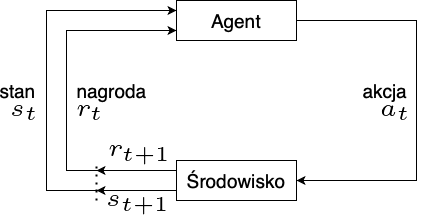

Zasada działania modelu uczenia ze wzmocnieniem jest następująca: autonomiczny agent, sterowany przez model, obserwuje **stan $s_t$ środowiska** w kroku czasowym $t$. Agent oddziałuje z otoczeniem podejmując **akcję $a_t$**, co powoduje przejście otoczenia i agenta do nowego stanu $s_{t+1}$. Przejście to odbywa się na podstawie **funkcji przejścia stanów $T(s_{t+1} | s_t, a_t)$** (równoważnej środowisku) - na podstawie aktualnego stanu i podjętej akcji. Zakładamy, że informacja o stanie jest wystarczająca dla agenta do podjęcia optymalnej akcji.

Sekwencja akcji wybierana jest na podstawie nagrody, przyznawanej przez otoczenie agentowi. Każde przejście środowiska do nowego stanu powoduje nagrodzenie agenta **nagrodą $r_t$**, tj. wartością skalarną, określającą "poprawność" podjętej decyzji. Celem uczenia modelu DRL jest wyuczenie **strategii**, maksymalizującej łączną uzyskiwaną wartość nagrody (*zwrot*).

Agent uczenia ze wzmocnieniem może składać się z następujących elementów (w zależności od stosowanego podejścia zawiera jeden lub więcej z nich):
* **strategia** (ang. *policy*), tj. funkcja zachowywania się agenta; może być deterministyczna $a = \pi(s)$ lub stochastyczna $\pi(a|s)=p(a_t=a | s_t=s)$;
* **funkcja wartości** (ang. *value function*), tj. funkcja służąca do predykcji przyszłej nagrody, używana do oceny stanów przy podejmowaniu akcji:
$$V_{\pi}(s)=\mathbb{E}\left[r_{t+1}+\gamma r_{t+2}+\gamma^2 r_{t+3}+\dots | s_t=s\right],$$
gdzie $\gamma\in[0, 1]$ to współczynnik dyskontowania, określający, w jakim stopniu faworyzowane są nagrody natychmiastowe;
* **model**, służący do predykcji zmian w środowisku:
$$\mathcal{P}_{ss'}^a = p(s_{t+1}=s | s_t=s, a_t=a),$$
$$\mathcal{R}_s^a = \mathbb{E}[r_{t+1} | s_t=s, a_t=a],$$
gdzie $\mathcal{P}$ przewiduje kolejny krok, a $\mathcal{R}$ wskazuje następną wartość nagrody.

W zależności od elementów metody uczenia ze wzmocnieniem dzielimy na:
* oparte na funkcji wartości (bez strategii) - trenujemy model aby poprawnie oceniał wartość nagrody za każdą z możliwych podejmowanych akcji,
* oparte na strategii (bez funkcji wartości) - *policy gradient* - trenujemy model strategii, która bezpośrednio zwraca akcje, maksymalizujące wartość nagrody,
* aktor-krytyk (wykorzystujące strategię oraz funkcję wartości) - połączenie powyższych (aktor to model strategii, kontrolujący zachowanie agenta, a krytyk to model funkcji wartości, oceniająca akcje podejmowane przez krytyka).

Każda z tych metod może być też *model-free* (bez wykorzystania modelu środowiska) lub *model-based* (modelująca środowisko).

W tym zadaniu skupimy się na **podejściu *model-free* opartym na funkcji wartości**.


## Funkcje wartości

Podejścia wykorzystujące funkcje wartości to metody oparte na estymowaniu wartości zwrotu (całkowitej nagrody). Wartość ta może być estymowana wyłącznie na podstawie aktualnego stanu - wówczas mówimy o **funkcji stan-wartość** $V^\pi(s) = \mathbb{E}[R | s, \pi]$, która ocenia wartość nagrody przy założeniu postępowania od danego stanu zgodnie ze strategią $\pi$. W idealnej sytuacji, optymalna strategia mogłaby być wybierana na podstawie akcji maksymalizujących oczekiwaną wartość nagrody; niestety jednak funkcja przejścia stanów $T(s_{t+1} | s_t, a_t)$ nie jest znana agentowi.

Rozwiązaniem jest konstrukcja funkcji, która będzie estymowała wartość zwrot na podstawie stanu oraz podejmowanej akcji - **funkcja jakości** $Q^\pi(s, a) = \mathbb{E}[R | s, a, \pi]$ - tu oceniana jest wartość zwrotu po podjęciu danej akcji w danym stanie, przy postępowaniu dalej zgodnie ze strategią $\pi$. Wówczas, najlepsza strategia może być znaleziona przez zachłanny wybór akcji maksymalizującej wartość funkcji $Q$: $\arg\max_a Q^\pi(s, a)$, w ten sposób definiując aproksymację poszukiwanej funkcji wartości na podstawie maksymalizowania funkcji jakości:

$$V^\pi(s) \approx \max_a Q^\pi(s, a).$$

W takim podejściu skupiamy się na eksploatacji aktualnie wykrytego maksimum; często jednak chcielibyśmy również eksplorować rozwiązania alternatywne, na co pozwala strategia $\epsilon$-zachłanna (z prawdopodobieństwem $1-\epsilon$ wybieramy maksymalizującą akcję, a z prawdopodobieństwem $\epsilon$ - losową).

Wartość funkcji jakości może być obliczona ze wzoru rekurencyjnego:

$$Q^\pi(s_t, a_t) = \mathbb{E}_{s_{t+1}}\left[r_t + \gamma Q^\pi\left(s_{t+1}, \pi(s_{t+1})\right)\right],$$

mówimy wówczas o podejściu *on-policy* - do estymacji całkowitej wartości zwrotu i wyboru akcji wykorzystuje się aktualną postać strategii (np. algorytm [SARSA](https://en.wikipedia.org/wiki/State–action–reward–state–action)). Alternatywnie, wybór akcji i estymacja wartości zwrotu może odbywać się poprzez zachłanny wybór akcji maksymalizującej wartość nagrody - mówimy wtedy o algorytmach *off-policy*:

$$Q^\pi(s_t, a_t) = \mathbb{E}_{s_{t+1}}\left[r_t + \gamma \max_a Q^\pi\left(s_{t+1}, a_{t+1}\right)\right].$$

Przykładem drugiej z grup metod jest [Q-learning](https://en.wikipedia.org/wiki/Q-learning). Polega on na budowaniu tabeli pamięci $Q[s, a]$, mającej przechowywać wartości funkcji jakości dla wszystkich możliwych kombinacji stanów $s$ i akcji $a$. Powstaje ona na skutek iteracyjnego próbkowania akcji z bieżącego stanu i zapisywania wartości zwrotu ($Y$), przy dalszym podejmowaniu akcji maksymalizujących wartość uzyskiwanej nagrody. Algorytm powtarzany jest iteracyjnie dla wszystkich możliwych akcji w danym stanie, po czym następuje przejście do kolejnego, niezbadanego stanu. W wytrenowanym modelu tabela ta wykorzystywana jest do wyboru akcji, maksymalizując wartość uzyskiwanej funkcji nagrody.


## Deep Q-Learning (DQL)

Algorytm Q-learning jest słabo skalowalny — w szczególności pod względem wymagań pamięciowych oraz złożoności obliczeniowej dla dużych przestrzeni stanów i akcji, dlatego też w DQN tabela pamięci została zastąpiona przez sieć głęboką (ang. *Deep Q-Network*), której zadaniem jest aproksymacja funkcji jakości $Q(s, a)$.

Uczenie tej sieci odbywa się np. z użyciem funkcji celu - błędu średniokwadratowego między predykcją sieci a końcowymi wartościami zwrotu

$$\mathcal{L} = \mathbb{E}\left[\left(r_t + \gamma \max_a Q^\pi\left(s_{t+1}, a_{t+1}\right) - Q^\pi\left(s_t, a_t\right)\right)^2\right].$$

Można także użyć [Huber loss](https://en.wikipedia.org/wiki/Huber_loss).

Algorytm uczenia tej sieci przedstawiony został poniżej:

```{tidy=FALSE, eval=FALSE}
Get(s);                                         // pobierz stan początkowy
for step <- 1, 2, ... till convergence do       // dla kolejnych kroków
    Sample(a);                                  // wybierz akcję (epsilon-zachłannie)
    Get(s');                                    // ustal nowy stan
    if s' is terminal then                      // jeżeli nowy stan jest stanem końcowym
        Y <- sum(r);                            // ustal wartość zwrotu
        Sample(new s');                         // pobierz nowy stan początkowy
    else:
        Y <- r + gamma * Q_step(s', a')'        // aktualizuj estymację zwrotu
    theta_k+1 <- theta - alpha * grad L(theta); // aktualizuj wagi zgodnie z funkcją celu
    s <- s';                                    // weź nowy stan jako aktualny
```

Wybrane ulepszenia:

- **Zmienna wartość $\epsilon$**.
    Zastosowanie stałej wartości $\epsilon$ w strategii $\epsilon$-zachłannej nie jest najlepszym rozwiązaniem. Zwykle wolelibyśmy, żeby w początkowym etapie model bardziej eksplorował przestrzeń (wyższy $\epsilon$), a w późniejszym etapie by eksploatował znalezione optimum (niższy $\epsilon$). Często stosuje się w tym celu funkcję wykładniczą.

- ***Target network***.
    Stosowane w celu poprawy stabilności trenowania. Polega ono na wykorzystaniu odrębnych instancji do działania w środowisku (*target network*) i odrębnej do trenowania w każdej iteracji (*policy network*). Początkowo, obie sieci są swoimi kopiami, a ich wagi są synchronizowane w trakcie trenowania w określonych interwałach. Algorytm trenowania modelu z *target network* prezentuje się następująco:

    1. Wykonaj kopię modelu (*target network*)
    1. Dla każdego kroku:
        - wykonuj akcję w środowisku z użyciem *policy network* i zapisz czwórkę [stan, akcja, następny stan, nagroda] do utworzenia mini-batcha
        - oblicz oczekiwane wartości funkcji Q używając *target network*
        - oblicz loss i wykonaj propagację wsteczną w *policy network*
    1. Cyklicznie synchronizuj wytrenowane wagi w *policy network* -> *target network*

- ***Experience replay***.
    Podobnie jak *target network* stosowane w celu poprawy stabilności trenowania. Polega ono na zapisywaniu czwórek: stan, akcja, kolejny stan i nagroda $(s_t, a_t, s_{t+1}, r_t)$ w pamięci o ograniczonej wielkości (*experience*). W celu uczenia modelu próbkujemy losowo mini-batch z *experience* i wykorzystujemy do trenowania. W ten sposób model uczony jest na danych niezależnych od siebie, poprawiając stabilność trenowania.

    Wykorzystując *experience replay* algorytm trenowania będzie wyglądał następująco:

    1. Zbuduj pamięć *experience* wykonując akcje niewytrenowanym modelem w środowisku i zapisując czwórki.
    1. Dla każdego kroku uczenia:
        - wykonaj akcję (1 lub więcej) w środowisku i zapisz w pamięci, usuwając najstarszy experience
        - próbkuj batch z experience losowo i wykorzystaj do trenowania modelu (trenowanie odbywa się analogicznie jak wcześniej)


### Uwaga ogólna

Modele DRL, szczególnie w najbardziej "podstawowych" formach są niestabilne przy trenowaniu, dlatego też stosuje się wiele ulepszeń. Ponadto każdy błąd implementacyjny może mieć bardzo duży wpływ na zdolność modelu do wytrenowania, dlatego też w tych listach będziemy się opierać na gotowych implementacjach z biblioteki [**Stable-Baselines3**](https://stable-baselines.readthedocs.io). Opiera się ona na PyTorchu i zawiera sprawdzone i przetestowane implementacje wielu popularnych metod głębokiego uczenia ze wzmocnieniem. W tym laboratorium skupimy się na wspomnianej wcześniej metodzie Deep Q-Learning.


## Środowisko

W laboratorium będziemy wykorzystali bibliotekę [Gym](https://gym.openai.com) - zestaw narzędzi do budowy i porównywania algorytmów uczenia ze wzmocnieniem. Zawiera ona środowiska o różnym poziomie złożoności - zaczniemy od prostego środowiska - [CartPole](https://gym.openai.com/envs/CartPole-v1/)

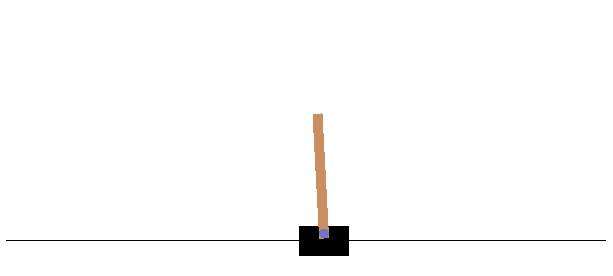
> oparte na: Barto, Sutton & Anderson *Neuronlike Adaptive Elements That Can Solve Difficult Learning Control Problem*, 1983

Słupek zamocowany jest do wózka, który porusza się bez tarcia po ścieżce. Przestrzeń stanów jest czteroelementowa:
* pozycja wózka,
* szybkość wózka,
* kąt nachylenia słupka,
* szybkość obrotu słupka.

Możemy kontrolować ruch wózka przykładając do niego siłę +1 lub -1. Celem jest zapobieganie przewróceniu słupka. Nagroda +1 przyznawana jest za każdy krok, kiedy słupek pozostaje pionowo. Epizod kończy się, gdy słupek odchylony jest o więcej niż 15 stopni od pionu, lub gry wózek odsunie się o ponad 2,4 jednostki od środka.


In [1]:
# !apt-get install -y xvfb > /dev/null 2>&1
# !apt-get install python-opengl > /dev/null 2>&1
# !pip install gym pyvirtualdisplay stable-baselines3[extra] > /dev/null 2>&1
!pip install 'stable-baselines3[extra]'
!pip install gym pyvirtualdisplay

In [46]:
!$PATH

import os
import random

import seaborn as sns
import gymnasium as gym
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import torch
from matplotlib import animation
from pyvirtualdisplay import Display
from stable_baselines3 import DQN
from stable_baselines3.common.evaluation import evaluate_policy
from stable_baselines3.common.monitor import Monitor
from stable_baselines3.common.results_plotter import plot_results, load_results
from stable_baselines3.dqn.policies import MlpPolicy

from IPython import display as ipythondisplay


SEED = 13
torch.manual_seed(SEED)
random.seed(SEED)
np.random.seed(SEED)

DISPLAY = Display(visible=0, size=(400, 300))
DISPLAY.start()


zsh:1: no such file or directory: /opt/miniconda3/envs/pytorch310/bin:/opt/miniconda3/condabin:/Users/ewojcik/.nvm/versions/node/v16.20.2/bin:/opt/homebrew/bin:/opt/homebrew/sbin:/usr/local/bin:/System/Cryptexes/App/usr/bin:/usr/bin:/bin:/usr/sbin:/sbin:/var/run/com.apple.security.cryptexd/codex.system/bootstrap/usr/local/bin:/var/run/com.apple.security.cryptexd/codex.system/bootstrap/usr/bin:/var/run/com.apple.security.cryptexd/codex.system/bootstrap/usr/appleinternal/bin:/opt/X11/bin:/Library/Apple/usr/bin:~/Code/pwr/GSN/10/models/fastText:/Users/ewojcik/Code/pwr/GSN/10/models/fastText


ImportError: cannot import name 'RecordVideo' from 'stable_baselines3.common.monitor' (/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/monitor.py)

Metoda Deep Q-Learning wraz z wymienionymi wcześniej ulepszeniami jest już zaimplementowana w bibliotece Stable-Baselines3. Najpierw sprawdźmy hiperparametry, jakie możemy podać do modelu:


In [3]:
help(DQN)


Help on class DQN in module stable_baselines3.dqn.dqn:

class DQN(stable_baselines3.common.off_policy_algorithm.OffPolicyAlgorithm)
 |  DQN(policy: Union[str, Type[stable_baselines3.dqn.policies.DQNPolicy]], env: Union[gymnasium.core.Env, ForwardRef('VecEnv'), str], learning_rate: Union[float, Callable[[float], float]] = 0.0001, buffer_size: int = 1000000, learning_starts: int = 100, batch_size: int = 32, tau: float = 1.0, gamma: float = 0.99, train_freq: Union[int, Tuple[int, str]] = 4, gradient_steps: int = 1, replay_buffer_class: Optional[Type[stable_baselines3.common.buffers.ReplayBuffer]] = None, replay_buffer_kwargs: Optional[Dict[str, Any]] = None, optimize_memory_usage: bool = False, target_update_interval: int = 10000, exploration_fraction: float = 0.1, exploration_initial_eps: float = 1.0, exploration_final_eps: float = 0.05, max_grad_norm: float = 10, stats_window_size: int = 100, tensorboard_log: Optional[str] = None, policy_kwargs: Optional[Dict[str, Any]] = None, verbose:

Kluczowym argumentem podawanym do modelu jest `policy`, czyli model strategii wykorzystywany w modelu. W Stable-Baselines3 każda metoda DRL posiada własny zestaw strategii - w przypadku DQN dostępne są trzy wersje (moduł `stable_baselines3.dqn.policies`:
- `MlpPolicy` - w pełni połączona
- `CnnPolicy` - z warstwami konwolucyjnymi
- `MultiInputPolicy` - dla środowisk, które umożliwiają obserwacje w formie obrazów jak i wartości.

W tym przykładzie będziemy wykorzystywać `MlpPolicy`, ponieważ środowisko nie zwraca obserwacji w formie obrazów. Sprawdźmy zatem, jakie argumenty ona przyjmuje (mogą one być przekazywane przez argument modelu `policy_kwargs`).


In [4]:
help(MlpPolicy)


Help on class DQNPolicy in module stable_baselines3.dqn.policies:

class DQNPolicy(stable_baselines3.common.policies.BasePolicy)
 |  DQNPolicy(observation_space: gymnasium.spaces.space.Space, action_space: gymnasium.spaces.discrete.Discrete, lr_schedule: Callable[[float], float], net_arch: Optional[List[int]] = None, activation_fn: Type[torch.nn.modules.module.Module] = <class 'torch.nn.modules.activation.ReLU'>, features_extractor_class: Type[stable_baselines3.common.torch_layers.BaseFeaturesExtractor] = <class 'stable_baselines3.common.torch_layers.FlattenExtractor'>, features_extractor_kwargs: Optional[Dict[str, Any]] = None, normalize_images: bool = True, optimizer_class: Type[torch.optim.optimizer.Optimizer] = <class 'torch.optim.adam.Adam'>, optimizer_kwargs: Optional[Dict[str, Any]] = None) -> None
 |  
 |  Policy class with Q-Value Net and target net for DQN
 |  
 |  :param observation_space: Observation space
 |  :param action_space: Action space
 |  :param lr_schedule: Learni

Szczególnie interesującym będzie dla nas argument `net_arch`, definiujący architekturę modelu strategii (jest to lista integerów, opisująca liczbę neuronów w poszczególnych warstwach ukrytych).


Deklarujemy funkcję do wyświetlania działania modelu. Poza tworzeniem animacji wykonuje ona również ewaluację modelu, sprawdzając w 100 epizodach osiąganą całkowitą wartość zwrotu.

Sprawdzimy od razu, jak zachowuje się niewytrenowany (losowy) model (zwróćmy uwagę, że musimy podać model strategii, jak i środowisko, w jakim model ma działać - możemy uzyskać do niego dostęp wywołując metodę modelu `get_env`).


In [5]:
def visualize_model(model, max_steps=500):
    """Show how a model works in the environment."""
    env = model.get_env()
    obs = env.reset()

    fig, ax = plt.subplots()
    frames = []
    done = False

    while not done:
        frames.append(env.render(mode="rgb_array"))
        with torch.no_grad():
            action, _ = model.predict(obs)
        obs, reward, done, info = env.step(action)
        if len(frames) >= max_steps:
            break

    anim = animation.FuncAnimation(
        fig=fig,
        func=lambda i: ax.imshow(frames[i]),
        frames=range(len(frames)),
        interval=100,
        blit=False,
    )
    plt.close()

    reward_avg, reward_std = evaluate_policy(model, env, n_eval_episodes=100)
    print(f"Reward in episode: {reward_avg:.2f} +/- {reward_std:.2f}")

    return anim.to_jshtml()


env = gym.make("CartPole-v1", render_mode="rgb_array")
model = DQN(MlpPolicy, env)
display(ipythondisplay.HTML(visualize_model(model)))


Reward in episode: 9.27 +/- 0.77


Zaczniemy od deklaracji uproszczonego modelu, ze stałą wartością $\epsilon$, bez target network oraz z experience replay o długości batcha (efektywnie - brakiem experience replay). Następnie będziemy chcieli włączać ulepszenia oraz stroić hiperparametry aby sprawdzić, jak wpływają one na działanie modelu. Do wytrenowania modelu służy metoda `learn`. Sprawdźmy jej parametry.


In [6]:
help(DQN.learn)

Help on function learn in module stable_baselines3.dqn.dqn:

learn(self: ~SelfDQN, total_timesteps: int, callback: Union[NoneType, Callable, List[ForwardRef('BaseCallback')], ForwardRef('BaseCallback')] = None, log_interval: int = 4, tb_log_name: str = 'DQN', reset_num_timesteps: bool = True, progress_bar: bool = False) -> ~SelfDQN
    Return a trained model.
    
    :param total_timesteps: The total number of samples (env steps) to train on
    :param callback: callback(s) called at every step with state of the algorithm.
    :param log_interval: for on-policy algos (e.g., PPO, A2C, ...) this is the number of
        training iterations (i.e., log_interval * n_steps * n_envs timesteps) before logging;
        for off-policy algos (e.g., TD3, SAC, ...) this is the number of episodes before
        logging.
    :param tb_log_name: the name of the run for TensorBoard logging
    :param reset_num_timesteps: whether or not to reset the current timestep number (used in logging)
    :param 

Z punktu widzenia analizy działania modelu potrzebna jest jedynie liczba kroków uczenia `total_timesteps`. Możemy też wyregulować częstość ewaluacji oraz logowania (wyświetlanie logu odbywa się jedynie przy ustawieniu `verbose=1`). Oprócz tego chcielibyśmy jednak także wyświetlić krzywą uczenia. Wykorzystujemy w tym celu wrapper na środowisko w Unity `Monitor`. Jako parametry przyjmuje on środowisko, które będziemy monitorować, oraz folder, w którym będziemy zapisywać logi. Możemy je potem wczytać i wyświetlić wykorzystując metody `load_results` i `plot_results`.


In [7]:
RESULTS_DIR = "/tmp/"

env = Monitor(env, filename=RESULTS_DIR)


Deklarujemy model. Ustawiając rozmiar bufora oraz start i częstość trenowania równe wielkości mini-batcha efektywnie wyłączamy experience replay, a aktualizując sieć w interwale równym wielkości batcha model trenowany będzie bez *target network*. Ponadto, dobieramy odpowiednio wartości schedulera $\epsilon$, tak, aby współczynnik ten był stały podczas trenowania.


In [8]:
batch_size = 64
lr = 1e-4
gamma = 0.8
eps = 0.1

env = gym.make("CartPole-v1", render_mode="rgb_array")
log_dir = "/tmp/vanilla/"
os.makedirs(log_dir, exist_ok=True)  # we have to create this dir - it does not exist
env = Monitor(env, filename=log_dir)

vanilla_dqn = DQN(
    MlpPolicy, env,
    learning_rate=lr, batch_size=batch_size, gamma=gamma, seed=SEED,
    buffer_size=batch_size, learning_starts=batch_size, train_freq=batch_size,  # disable experience replay
    target_update_interval=batch_size,  # disable target network
    exploration_fraction=1, exploration_initial_eps=eps, exploration_final_eps=eps,  # disable epsilon scheduling
    verbose=1,  # show information throughout training
)


Using cpu device
Wrapping the env in a DummyVecEnv.


Wytrenujmy zatem taki prosty model w 100 000 kroków i sprawdźmy jakie osiągnie on po tym czasie rezultaty.


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.8     |
|    ep_rew_mean      | 18.8     |
|    exploration_rate | 0.1      |
| time/               |          |
|    episodes         | 4        |
|    fps              | 19773    |
|    time_elapsed     | 0        |
|    total_timesteps  | 75       |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.5     |
|    ep_rew_mean      | 14.5     |
|    exploration_rate | 0.1      |
| time/               |          |
|    episodes         | 8        |
|    fps              | 16068    |
|    time_elapsed     | 0        |
|    total_timesteps  | 116      |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13       |
|    ep_rew_mean      | 13       |
|    exploration_rate | 0.1      |
| time/               |          |
|    episodes       

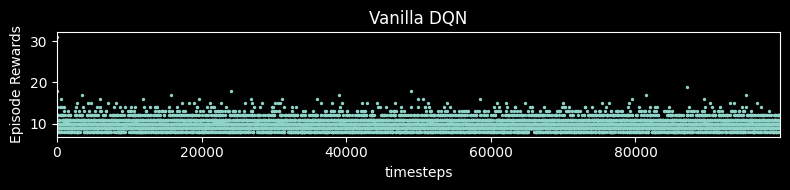

In [9]:
total_timesteps = 100000

vanilla_dqn.learn(total_timesteps)
display(ipythondisplay.HTML(visualize_model(vanilla_dqn)))
plot_results([log_dir], total_timesteps, "timesteps", "Vanilla DQN")


Jak widać, metoda Deep Q-Learning w domyślnym ustawieniu nie działa zbyt dobrze - model nie zbiega, oscylując wokół początkowych wartości nagrody. Być może strojenie hiperparametrów poprawiłoby osiągane rezultaty?

Sprawdźmy, jaka była maksymalna wartość zgromadzona w trakcie uczenia. Posłuży nam w tym celu funkcja `load_results`. Zwraca ona pandasowy DataFrame, w którym znajdują się informacje o każdym epizodzie w trakcie trenowania: uzyskanej nagrodzie `r`, długości epizodu `l` oraz jego czasie trwania `t`.


In [10]:
results = load_results(log_dir)
display(results.head(5))
print(f"Max reward: {results.r.max()}")


,index,r,l,t
0,0,14.0,14,0.007277
1,1,18.0,18,0.007663
2,2,12.0,12,0.007904
3,3,31.0,31,0.009607
4,4,11.0,11,0.011059


Max reward: 31.0


Spróbujemy powtórzyć wytrenowanie modelu, tym razem z wykorzystaniem *experience replay*.

Using cpu device
Wrapping the env in a DummyVecEnv.
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18       |
|    ep_rew_mean      | 18       |
|    exploration_rate | 0.993    |
| time/               |          |
|    episodes         | 4        |
|    fps              | 30508    |
|    time_elapsed     | 0        |
|    total_timesteps  | 72       |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 16.1     |
|    ep_rew_mean      | 16.1     |
|    exploration_rate | 0.988    |
| time/               |          |
|    episodes         | 8        |
|    fps              | 13167    |
|    time_elapsed     | 0        |
|    total_timesteps  | 129      |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.695    |
|    n_updates        | 7        |
----------------------------------
----------------------------------
| r

Max reward: 500.0


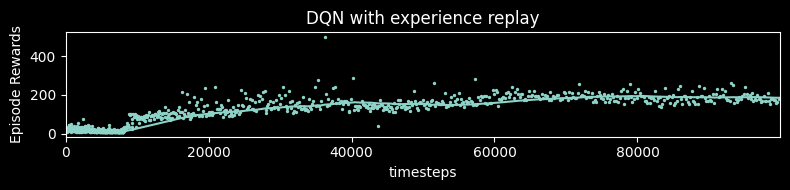

In [11]:
batch_size = 64
lr = 1e-4
gamma = 0.8

env = gym.make("CartPole-v1", render_mode="rgb_array")
log_dir = "/tmp/exp_replay/"
os.makedirs(log_dir, exist_ok=True)
env = Monitor(env, filename=log_dir)

dqn_exp = DQN(
    MlpPolicy, env,
    learning_rate=lr, batch_size=batch_size, gamma=gamma, seed=SEED,
    target_update_interval=batch_size,  # disable target network
    verbose=1,  # show information throughout training
)

total_timesteps = 100000

dqn_exp.learn(total_timesteps)
display(ipythondisplay.HTML(visualize_model(dqn_exp)))
plot_results([log_dir], total_timesteps, "timesteps", "DQN with experience replay")
results = load_results(log_dir)
print(f"Max reward: {results.r.max()}")


Jak widać rezultaty są dużo lepsze. Ale może udałoby się poprawić proces trenowania? Tego dotyczyć będą zadania.


## Zadanie 1

Zbadaj wpływ pozostałych ze wspomnianych hipeparametrów na trenowanie i działanie modelu. 
Skup się na: 
- zmianie architektury modelu strategii, 
- hiperparametrach trenowania 
    - gamma, 
    - epsilon,
    - tau,
    - learning_rate 
    
Zapisz swoje wnioski oraz przygotuj wizualizacje uzyskiwanych rezultatów oraz animacje działania modelu.


In [12]:
def experiment_dqn(env, architecture, lr, gamma, epsilon, tau, total_timesteps, log_dir, verbose=1):
    os.makedirs(log_dir, exist_ok=True)
    env = Monitor(gym.make("CartPole-v1", render_mode="rgb_array"), filename=log_dir)
    model = DQN(
        MlpPolicy, env,
        learning_rate=lr,
        batch_size=64,
        tau=tau,
        gamma=gamma,
        policy_kwargs=dict(net_arch=architecture),
        exploration_initial_eps=epsilon,
        exploration_final_eps=epsilon,
        seed=SEED,
        verbose=verbose,
    )
    model.learn(total_timesteps=total_timesteps)
    reward_avg, reward_std = evaluate_policy(model, env, n_eval_episodes=100)
    return reward_avg, reward_std, model

In [13]:
def run_experiments(env, architectures, lrs, gammas, epsilons, taus, total_timesteps):
    results_data = []
    configurations = [(arch, lr, gamma, epsilon, tau) for arch in architectures for lr in lrs for gamma in gammas for epsilon in epsilons for tau in taus]

    for architecture, lr, gamma, epsilon, tau in configurations:
        arch_str = "_".join(map(str, architecture))
        print(f"Running DQN with architecture {architecture}, lr={lr}, gamma={gamma}, epsilon={epsilon}")
        log_dir = f"/tmp/dqn_{arch_str}_{lr}_{gamma}_{epsilon}/"
        
        avg_reward, std_reward, _ = experiment_dqn(
            env, 
            architecture, 
            lr, 
            gamma, 
            epsilon, 
            total_timesteps, 
            log_dir,
            verbose=0
        )
        
        results_data.append({
            "Architecture": arch_str,
            "Learning Rate": lr,
            "Gamma": gamma,
            "Epsilon": epsilon,
            "Tau": tau,
            "Average Reward": avg_reward,
            "STD Reward": std_reward
        })
    
    return pd.DataFrame(results_data)

In [18]:
architectures = [[32], [64, 64], [128, 64, 32]]
learning_rates = [0.001, 0.0005]
gammas = [0.95, 0.99]
epsilons = [0.1, 0.05]
taus = [1]

total_timesteps = 50_000
results_df = run_experiments(
    env, 
    architectures, 
    learning_rates, 
    gammas, 
    epsilons, 
    taus, 
    total_timesteps
)

Running DQN with architecture [32], lr=0.001, gamma=0.95, epsilon=0.1
Using cpu device
Wrapping the env in a DummyVecEnv.
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18       |
|    ep_rew_mean      | 18       |
|    exploration_rate | 0.1      |
| time/               |          |
|    episodes         | 4        |
|    fps              | 27896    |
|    time_elapsed     | 0        |
|    total_timesteps  | 72       |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.2     |
|    ep_rew_mean      | 18.2     |
|    exploration_rate | 0.1      |
| time/               |          |
|    episodes         | 8        |
|    fps              | 7808     |
|    time_elapsed     | 0        |
|    total_timesteps  | 146      |
| train/              |          |
|    learning_rate    | 0.001    |
|    loss             | 0.664    |
|    n_updates        | 11       |
---

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.5     |
|    ep_rew_mean      | 12.5     |
|    exploration_rate | 0.1      |
| time/               |          |
|    episodes         | 24       |
|    fps              | 5701     |
|    time_elapsed     | 0        |
|    total_timesteps  | 301      |
| train/              |          |
|    learning_rate    | 0.001    |
|    loss             | 0.281    |
|    n_updates        | 50       |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.2     |
|    ep_rew_mean      | 12.2     |
|    exploration_rate | 0.1      |
| time/               |          |
|    episodes         | 28       |
|    fps              | 5606     |
|    time_elapsed     | 0        |
|    total_timesteps  | 341      |
| train/              |          |
|    learning_rate    | 0.001    |
|    loss             | 0.199    |
|    n_updates      

In [ ]:
results_df.head(30)

   Architecture  Learning Rate  Gamma  Epsilon  Tau  Average Reward  \
0            32         0.0010   0.95     0.10    1          171.86   
1            32         0.0010   0.95     0.05    1          127.14   
2            32         0.0010   0.99     0.10    1          133.72   
3            32         0.0010   0.99     0.05    1          132.09   
4            32         0.0005   0.95     0.10    1          135.20   
5            32         0.0005   0.95     0.05    1           25.45   
6            32         0.0005   0.99     0.10    1           15.60   
7            32         0.0005   0.99     0.05    1            9.27   
8         64_64         0.0010   0.95     0.10    1           77.06   
9         64_64         0.0010   0.95     0.05    1          161.43   
10        64_64         0.0010   0.99     0.10    1          196.39   
11        64_64         0.0010   0.99     0.05    1          149.43   
12        64_64         0.0005   0.95     0.10    1          126.18   
13    

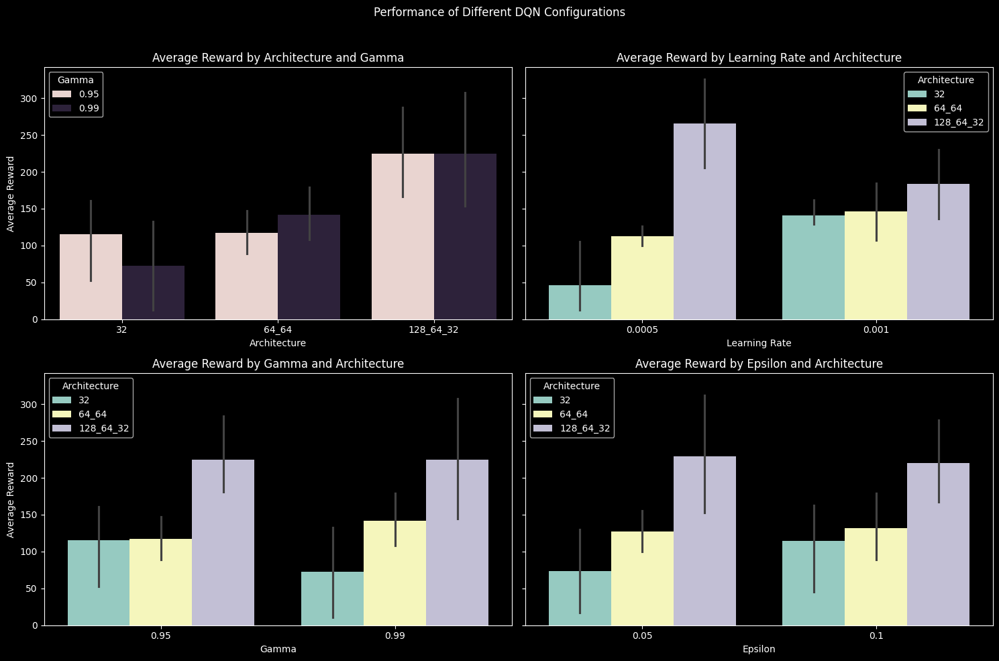

In [20]:
def plot_experiment_results(results_df):
    fig, axes = plt.subplots(2, 2, figsize=(15, 10), sharey=True)
    fig.suptitle('Performance of Different DQN Configurations')
    
    sns.barplot(ax=axes[0, 0], data=results_df, x='Architecture', y='Average Reward', hue='Gamma')
    axes[0, 0].set_title('Average Reward by Architecture and Gamma')
    axes[0, 0].legend(title='Gamma')

    sns.barplot(ax=axes[0, 1], data=results_df, x='Learning Rate', y='Average Reward', hue='Architecture')
    axes[0, 1].set_title('Average Reward by Learning Rate and Architecture')
    axes[0, 1].legend(title='Architecture')

    sns.barplot(ax=axes[1, 0], data=results_df, x='Gamma', y='Average Reward', hue='Architecture')
    axes[1, 0].set_title('Average Reward by Gamma and Architecture')
    axes[1, 0].legend(title='Architecture')

    sns.barplot(ax=axes[1, 1], data=results_df, x='Epsilon', y='Average Reward', hue='Architecture')
    axes[1, 1].set_title('Average Reward by Epsilon and Architecture')
    axes[1, 1].legend(title='Architecture')

    plt.tight_layout(rect=[0, 0, 1, 0.96]) 
    plt.show()

plot_experiment_results(results_df)

### Rekreacja najlepszego modelu oraz wizualizacja (zmniejszona ilość `max_steps`)

Using cpu device
Wrapping the env in a DummyVecEnv.
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18       |
|    ep_rew_mean      | 18       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 29471    |
|    time_elapsed     | 0        |
|    total_timesteps  | 72       |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 17.8     |
|    ep_rew_mean      | 17.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8        |
|    fps              | 8099     |
|    time_elapsed     | 0        |
|    total_timesteps  | 142      |
| train/              |          |
|    learning_rate    | 0.0005   |
|    loss             | 0.497    |
|    n_updates        | 10       |
----------------------------------
----------------------------------
| r

Max reward: 500.0


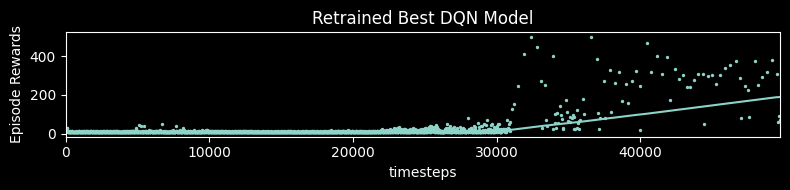

In [22]:
best_config = results_df.loc[results_df['Average Reward'].idxmax()]

env = gym.make("CartPole-v1", render_mode="rgb_array")
log_dir = "/tmp/best_model_retrain/"

bm_reward_avg, bm_reward_std, best_model = experiment_dqn(
    env = env, 
    architecture = [int(x) for x in best_config['Architecture'].split('_')], 
    lr = best_config['Learning Rate'], 
    gamma = best_config['Gamma'], 
    epsilon = best_config['Epsilon'], 
    tau = best_config['Tau'],
    total_timesteps = total_timesteps, 
    log_dir = log_dir
)
print(f"Best model average reward: {bm_reward_avg:.2f} +/- {bm_reward_std:.2f}")
display(ipythondisplay.HTML(visualize_model(best_model, max_steps=100)))
plot_results([log_dir], total_timesteps, "timesteps", "Retrained Best DQN Model")
results = load_results(log_dir)
print(f"Max reward: {results.r.max()}")


## Zadanie 2

Wykorzystaj metodę Deep Q-Learning do przygotowania agenta działającego w wybranym innym środowisku z biblioteki [Gym](https://gym.openai.com/envs). Ze względu na cechy modelu zwróć uwagę na dopasowanie środowiska (np. przestrzeń akcji powinna być dyskretna). Zapoznaj się z definicją funkcji nagrody przyznawanej agentowi w środowisku, aby można było zinterpretować rezultaty osiągane przez model. Jeśli zdecydujesz się na wykorzystanie środowiska z obserwacjami wizualnymi, pamiętaj o zmianie typu modelu strategii (uwaga: trenowanie modeli w oparciu o obserwacje wizualne z wykorzystaniem sieci konwolucyjnym jest długotrwałe i może być bardziej niestabilne niż w przypadku strategii MLP). Spróbuj dostroić hiperparametry trenowania do nowego środowiska.


In [37]:
from stable_baselines3 import DQN
from stable_baselines3.dqn.policies import CnnPolicy
from stable_baselines3.common.vec_env import VecFrameStack
from stable_baselines3.common.env_util import make_atari_env
from stable_baselines3.common.evaluation import evaluate_policy

env_name = "BreakoutNoFrameskip-v4"
env = make_atari_env(env_name, n_envs=1, seed=13)
env = VecFrameStack(env, n_stack=4)  # Stack 4 frames

# Initialize DQN with a CNN policy
model = DQN(
    CnnPolicy, env, 
    verbose=0, 
    learning_rate=1e-4, 
    buffer_size=10000, 
    learning_starts=1000, 
    batch_size=32, 
    tau=1.0, 
    gamma=0.99, 
    train_freq=4, 
    gradient_steps=1, 
    target_update_interval=1000, 
    exploration_fraction=0.1, 
    exploration_final_eps=0.01, 
    exploration_initial_eps=1.0)


total_timesteps = 100_000
model.learn(total_timesteps=total_timesteps)

mean_reward, std_reward = evaluate_policy(model, model.get_env(), n_eval_episodes=10)
print(f"Mean reward: {mean_reward} +/- {std_reward}")

model.save("dqn_breakout")

Using cpu device
Wrapping the env in a VecTransposeImage.
----------------------------------
| rollout/            |          |
|    exploration_rate | 0.983    |
| time/               |          |
|    episodes         | 4        |
|    fps              | 1140     |
|    time_elapsed     | 0        |
|    total_timesteps  | 167      |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 814      |
|    ep_rew_mean      | 2        |
|    exploration_rate | 0.975    |
| time/               |          |
|    episodes         | 8        |
|    fps              | 1209     |
|    time_elapsed     | 0        |
|    total_timesteps  | 255      |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 770      |
|    ep_rew_mean      | 1.5      |
|    exploration_rate | 0.961    |
| time/               |          |
|    episodes         | 12      

In [75]:
def visualize_atari_model(model, env, max_steps=1_000):
    """Visualize the model playing an Atari game."""
    obs = env.reset()
    
    fig, ax = plt.subplots()
    img = ax.imshow(env.render(mode='rgb_array')) 
    plt.axis('off')
    frames = []
    
    for _ in range(max_steps):
        frames.append(env.render(mode='rgb_array'))
        action, _states = model.predict(obs, deterministic=True)
        obs, rewards, dones, info = env.step(action)
        if dones:
            print("Game Over")
            break

    anim = animation.FuncAnimation(fig, lambda i: img.set_data(frames[i]), frames=len(frames), interval=50)
    plt.close(fig)
    return ipythondisplay.HTML(anim.to_jshtml())


env = make_atari_env(env_name, n_envs=1, seed=13)
env = VecFrameStack(env, n_stack=4)
animation_html = visualize_atari_model(model, env)
ipythondisplay.display(animation_html)

/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/gymnasium/utils/passive_env_checker.py:335: UserWarning: WARN: No render fps was declared in the environment (env.metadata['render_fps'] is None or not defined), rendering may occur at inconsistent fps.
  logger.warn(


Game Over


In [147]:
import itertools
from tqdm.auto import tqdm

hyperparameters = {
    'learning_rate': [1e-4, 5e-4, 1e-3],
    'gamma': [0.99, 0.95],
    'epsilon_start': [1.0, 0.7],
    'epsilon_end': [0.01, 0.1],
    'architecture': [[32, 32], [64, 64], [32, 64, 32]]
}

param_combinations = list(itertools.product(*hyperparameters.values()))

def run_experiment(params, env, total_timesteps=10_000, i = 0):
    learning_rate, gamma, epsilon_start, epsilon_end, architecture = params
    model = DQN(
        CnnPolicy, env, 
        learning_rate=learning_rate,
        gamma=gamma,
        exploration_initial_eps=epsilon_start,
        exploration_final_eps=epsilon_end,
        policy_kwargs={"net_arch": architecture},
        verbose=0
    )
    model.learn(total_timesteps=total_timesteps)
    
    obs = env.reset()
    
    fig, ax = plt.subplots()
    img = ax.imshow(env.render(mode='rgb_array')) 
    plt.axis('off')
    frames = []
    bounces = 0
    for _ in range(1000):
        frames.append(env.render(mode='rgb_array'))
        action, _states = model.predict(obs, deterministic=True)
        obs, rewards, done, info = env.step(action)
        if rewards > 0:
            bounces += 1
        if done:
            break

    anim = animation.FuncAnimation(fig, lambda i: img.set_data(frames[i]), frames=len(frames), interval=50)
    plt.close(fig)
    ipythondisplay.display(ipythondisplay.HTML(anim.to_jshtml()))

    mean_reward, std_reward = evaluate_policy(model, env, n_eval_episodes=10)
    print(f'For params: {params}\nMean reward: {mean_reward} +/- {std_reward}\nBounces: {bounces}')
    
    model.save(f"experiments/{i}_model_{bounces}_bounces_{int(mean_reward)}_reward")

    return mean_reward, std_reward, bounces

In [ ]:
env = VecFrameStack(make_atari_env("BreakoutNoFrameskip-v4", n_envs=1), n_stack=4)
atari_results = []

total_timesteps=20_000
i = 0
for params in tqdm(param_combinations, desc="Hyperparameter Tuning"):
    mean_reward, std_reward, bounces = run_experiment(params, env, total_timesteps, i)
    i += 1
    atari_results.append({
        "params": dict(zip(hyperparameters.keys(), params)),
        "reward": mean_reward,
        "std_reward": std_reward,
        "bounces": bounces
    })

In [141]:

env_name = "BreakoutNoFrameskip-v4"
env = make_atari_env(env_name, n_envs=1, seed=13)
env = VecFrameStack(env, n_stack=4)
# model = DQN.load("experiments/0_model_0bounces_params:(0.0001, 0.99, 1.0, 0.01, [32, 32])")
# model = DQN.load("experiments/1_model_0bounces_params:(0.0001, 0.99, 1.0, 0.01, [64, 64])")
# model = DQN.load("experiments/2_model_0bounces_params:(0.0001, 0.99, 1.0, 0.01, [32, 64, 32])")

# model = DQN.load("experiments/0_model_0bounces_2.00reward")
# model = DQN.load("experiments/")
model = DQN.load("experiments/3_model_1bounces_1.90reward")
animation_html = visualize_atari_model(model, env)
ipythondisplay.display(animation_html)

/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.03GB
  warnings.warn(
/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/gymnasium/utils/passive_env_checker.py:335: UserWarning: WARN: No render fps was declared in the environment (env.metadata['render_fps'] is None or not defined), rendering may occur at inconsistent fps.
  logger.warn(


Game Over


In [ ]:
wyjeb sie tutaj

In [90]:
env = VecFrameStack(make_atari_env("BreakoutNoFrameskip-v4", n_envs=1), n_stack=4)
atari_results = []

total_timesteps=10_000
i = 0
for params in tqdm(param_combinations, desc="Hyperparameter Tuning"):
    mean_reward, std_reward, bounces = run_experiment(params, env, total_timesteps, i)
    i += 1
    atari_results.append({
        "params": dict(zip(hyperparameters.keys(), params)),
        "reward": mean_reward,
        "std_reward": std_reward,
        "bounces": bounces
    })


Hyperparameter Tuning:   0%|          | 0/72 [00:00<?, ?it/s]/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.27GB
  warnings.warn(
Hyperparameter Tuning:   1%|▏         | 1/72 [02:14<2:38:55, 134.31s/it]

For params: (0.0001, 0.99, 1.0, 0.01, [32, 32])
Mean reward: 2.7 +/- 4.124318125460256
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.71GB
  warnings.warn(
Hyperparameter Tuning:   3%|▎         | 2/72 [04:29<2:37:14, 134.77s/it]

For params: (0.0001, 0.99, 1.0, 0.01, [64, 64])
Mean reward: 2.9 +/- 3.112876483254676
Bounces: 1


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.11GB
  warnings.warn(
Hyperparameter Tuning:   4%|▍         | 3/72 [06:45<2:35:55, 135.58s/it]

For params: (0.0001, 0.99, 1.0, 0.01, [32, 64, 32])
Mean reward: 0.9 +/- 2.7
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.84GB
  warnings.warn(
Hyperparameter Tuning:   6%|▌         | 4/72 [09:02<2:34:09, 136.03s/it]

For params: (0.0001, 0.99, 1.0, 0.1, [32, 32])
Mean reward: 2.8 +/- 4.069397989875161
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.67GB
  warnings.warn(
Hyperparameter Tuning:   7%|▋         | 5/72 [11:20<2:32:30, 136.58s/it]

For params: (0.0001, 0.99, 1.0, 0.1, [64, 64])
Mean reward: 2.7 +/- 4.124318125460256
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.86GB
  warnings.warn(
Hyperparameter Tuning:   8%|▊         | 6/72 [13:37<2:30:31, 136.84s/it]

For params: (0.0001, 0.99, 1.0, 0.1, [32, 64, 32])
Mean reward: 1.8 +/- 3.709447398198282
Bounces: 1


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.57GB
  warnings.warn(
Hyperparameter Tuning:  10%|▉         | 7/72 [15:56<2:28:52, 137.42s/it]

For params: (0.0001, 0.99, 0.7, 0.01, [32, 32])
Mean reward: 2.1 +/- 0.3
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.82GB
  warnings.warn(
Hyperparameter Tuning:  11%|█         | 8/72 [18:12<2:26:16, 137.13s/it]

For params: (0.0001, 0.99, 0.7, 0.01, [64, 64])
Mean reward: 2.5 +/- 0.5
Bounces: 1


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.75GB
  warnings.warn(
Hyperparameter Tuning:  12%|█▎        | 9/72 [20:32<2:24:54, 138.00s/it]

For params: (0.0001, 0.99, 0.7, 0.01, [32, 64, 32])
Mean reward: 2.7 +/- 4.124318125460256
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.66GB
  warnings.warn(
Hyperparameter Tuning:  14%|█▍        | 10/72 [22:49<2:22:06, 137.53s/it]

For params: (0.0001, 0.99, 0.7, 0.1, [32, 32])
Mean reward: 0.8 +/- 0.4
Bounces: 1


Hyperparameter Tuning:  15%|█▌        | 11/72 [25:04<2:19:02, 136.77s/it]

For params: (0.0001, 0.99, 0.7, 0.1, [64, 64])
Mean reward: 0.0 +/- 0.0
Bounces: 0


Hyperparameter Tuning:  17%|█▋        | 12/72 [27:20<2:16:37, 136.62s/it]

For params: (0.0001, 0.99, 0.7, 0.1, [32, 64, 32])
Mean reward: 3.6 +/- 4.409081537009721
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.13GB
  warnings.warn(
Hyperparameter Tuning:  18%|█▊        | 13/72 [29:35<2:13:56, 136.21s/it]

For params: (0.0001, 0.95, 1.0, 0.01, [32, 32])
Mean reward: 1.3 +/- 1.5524174696260025
Bounces: 2


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.59GB
  warnings.warn(
Hyperparameter Tuning:  19%|█▉        | 14/72 [31:51<2:11:37, 136.17s/it]

For params: (0.0001, 0.95, 1.0, 0.01, [64, 64])
Mean reward: 3.3 +/- 5.040833264451424
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.55GB
  warnings.warn(
Hyperparameter Tuning:  21%|██        | 15/72 [34:08<2:09:28, 136.29s/it]

For params: (0.0001, 0.95, 1.0, 0.01, [32, 64, 32])
Mean reward: 2.0 +/- 0.0
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.52GB
  warnings.warn(
Hyperparameter Tuning:  22%|██▏       | 16/72 [36:23<2:06:59, 136.06s/it]

For params: (0.0001, 0.95, 1.0, 0.1, [32, 32])
Mean reward: 2.0 +/- 4.0
Bounces: 1


Hyperparameter Tuning:  24%|██▎       | 17/72 [38:39<2:04:43, 136.07s/it]

For params: (0.0001, 0.95, 1.0, 0.1, [64, 64])
Mean reward: 2.1 +/- 0.3
Bounces: 3


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.54GB
  warnings.warn(
Hyperparameter Tuning:  25%|██▌       | 18/72 [40:56<2:02:28, 136.08s/it]

For params: (0.0001, 0.95, 1.0, 0.1, [32, 64, 32])
Mean reward: 0.0 +/- 0.0
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.69GB
  warnings.warn(
Hyperparameter Tuning:  26%|██▋       | 19/72 [43:10<1:59:50, 135.67s/it]

For params: (0.0001, 0.95, 0.7, 0.01, [32, 32])
Mean reward: 0.2 +/- 0.6000000000000001
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.78GB
  warnings.warn(
Hyperparameter Tuning:  28%|██▊       | 20/72 [45:26<1:57:41, 135.79s/it]

For params: (0.0001, 0.95, 0.7, 0.01, [64, 64])
Mean reward: 0.3 +/- 0.9000000000000001
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 6.74GB
  warnings.warn(
Hyperparameter Tuning:  29%|██▉       | 21/72 [47:41<1:55:03, 135.37s/it]

For params: (0.0001, 0.95, 0.7, 0.01, [32, 64, 32])
Mean reward: 3.3 +/- 5.040833264451424
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.64GB
  warnings.warn(
Hyperparameter Tuning:  31%|███       | 22/72 [49:51<1:51:38, 133.97s/it]

For params: (0.0001, 0.95, 0.7, 0.1, [32, 32])
Mean reward: 2.7 +/- 4.124318125460256
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.66GB
  warnings.warn(
Hyperparameter Tuning:  32%|███▏      | 23/72 [52:01<1:48:22, 132.71s/it]

For params: (0.0001, 0.95, 0.7, 0.1, [64, 64])
Mean reward: 1.4 +/- 2.8
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.69GB
  warnings.warn(
Hyperparameter Tuning:  33%|███▎      | 24/72 [54:10<1:45:19, 131.65s/it]

For params: (0.0001, 0.95, 0.7, 0.1, [32, 64, 32])
Mean reward: 3.3 +/- 5.040833264451424
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.37GB
  warnings.warn(
Hyperparameter Tuning:  35%|███▍      | 25/72 [56:19<1:42:30, 130.87s/it]

For params: (0.0005, 0.99, 1.0, 0.01, [32, 32])
Mean reward: 2.3 +/- 0.9
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.82GB
  warnings.warn(
Hyperparameter Tuning:  36%|███▌      | 26/72 [58:29<1:40:05, 130.55s/it]

For params: (0.0005, 0.99, 1.0, 0.01, [64, 64])
Mean reward: 2.7 +/- 4.124318125460256
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.81GB
  warnings.warn(
Hyperparameter Tuning:  38%|███▊      | 27/72 [1:00:40<1:37:59, 130.65s/it]

For params: (0.0005, 0.99, 1.0, 0.01, [32, 64, 32])
Mean reward: 2.7 +/- 4.124318125460256
Bounces: 0


Hyperparameter Tuning:  39%|███▉      | 28/72 [1:02:49<1:35:31, 130.27s/it]

For params: (0.0005, 0.99, 1.0, 0.1, [32, 32])
Mean reward: 3.3 +/- 5.040833264451424
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.80GB
  warnings.warn(
Hyperparameter Tuning:  40%|████      | 29/72 [1:04:58<1:33:01, 129.79s/it]

For params: (0.0005, 0.99, 1.0, 0.1, [64, 64])
Mean reward: 0.2 +/- 0.4000000000000001
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.79GB
  warnings.warn(
Hyperparameter Tuning:  42%|████▏     | 30/72 [1:07:07<1:30:36, 129.43s/it]

For params: (0.0005, 0.99, 1.0, 0.1, [32, 64, 32])
Mean reward: 3.3 +/- 5.040833264451424
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.78GB
  warnings.warn(
Hyperparameter Tuning:  43%|████▎     | 31/72 [1:09:16<1:28:25, 129.40s/it]

For params: (0.0005, 0.99, 0.7, 0.01, [32, 32])
Mean reward: 2.2 +/- 4.4
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.50GB
  warnings.warn(
Hyperparameter Tuning:  44%|████▍     | 32/72 [1:11:25<1:26:06, 129.17s/it]

For params: (0.0005, 0.99, 0.7, 0.01, [64, 64])
Mean reward: 1.1 +/- 3.3
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.49GB
  warnings.warn(
Hyperparameter Tuning:  46%|████▌     | 33/72 [1:13:35<1:24:07, 129.43s/it]

For params: (0.0005, 0.99, 0.7, 0.01, [32, 64, 32])
Mean reward: 1.5 +/- 2.29128784747792
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.48GB
  warnings.warn(
Hyperparameter Tuning:  47%|████▋     | 34/72 [1:15:44<1:21:50, 129.23s/it]

For params: (0.0005, 0.99, 0.7, 0.1, [32, 32])
Mean reward: 0.2 +/- 0.6000000000000001
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.75GB
  warnings.warn(
Hyperparameter Tuning:  49%|████▊     | 35/72 [1:17:54<1:19:52, 129.52s/it]

For params: (0.0005, 0.99, 0.7, 0.1, [64, 64])
Mean reward: 3.6 +/- 4.409081537009721
Bounces: 0


Hyperparameter Tuning:  50%|█████     | 36/72 [1:20:03<1:17:43, 129.55s/it]

For params: (0.0005, 0.99, 0.7, 0.1, [32, 64, 32])
Mean reward: 2.2 +/- 0.6
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.70GB
  warnings.warn(
Hyperparameter Tuning:  51%|█████▏    | 37/72 [1:22:13<1:15:33, 129.52s/it]

For params: (0.0005, 0.95, 1.0, 0.01, [32, 32])
Mean reward: 1.4 +/- 2.9393876913398134
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.71GB
  warnings.warn(
Hyperparameter Tuning:  53%|█████▎    | 38/72 [1:24:23<1:13:26, 129.61s/it]

For params: (0.0005, 0.95, 1.0, 0.01, [64, 64])
Mean reward: 1.0 +/- 2.0
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.68GB
  warnings.warn(
Hyperparameter Tuning:  54%|█████▍    | 39/72 [1:26:32<1:11:18, 129.65s/it]

For params: (0.0005, 0.95, 1.0, 0.01, [32, 64, 32])
Mean reward: 0.3 +/- 0.9000000000000001
Bounces: 1


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.65GB
  warnings.warn(
Hyperparameter Tuning:  56%|█████▌    | 40/72 [1:28:42<1:09:11, 129.73s/it]

For params: (0.0005, 0.95, 1.0, 0.1, [32, 32])
Mean reward: 1.8 +/- 0.6000000000000001
Bounces: 0


Hyperparameter Tuning:  57%|█████▋    | 41/72 [1:30:52<1:07:01, 129.73s/it]

For params: (0.0005, 0.95, 1.0, 0.1, [64, 64])
Mean reward: 0.6 +/- 1.2
Bounces: 2


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.35GB
  warnings.warn(
Hyperparameter Tuning:  58%|█████▊    | 42/72 [1:33:01<1:04:49, 129.67s/it]

For params: (0.0005, 0.95, 1.0, 0.1, [32, 64, 32])
Mean reward: 2.2 +/- 4.4
Bounces: 0


Hyperparameter Tuning:  60%|█████▉    | 43/72 [1:35:11<1:02:41, 129.72s/it]

For params: (0.0005, 0.95, 0.7, 0.01, [32, 32])
Mean reward: 2.0 +/- 0.0
Bounces: 2


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.34GB
  warnings.warn(
Hyperparameter Tuning:  61%|██████    | 44/72 [1:37:21<1:00:34, 129.80s/it]

For params: (0.0005, 0.95, 0.7, 0.01, [64, 64])
Mean reward: 2.5 +/- 0.5
Bounces: 1


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.63GB
  warnings.warn(
Hyperparameter Tuning:  62%|██████▎   | 45/72 [1:39:31<58:20, 129.65s/it]  

For params: (0.0005, 0.95, 0.7, 0.01, [32, 64, 32])
Mean reward: 0.1 +/- 0.30000000000000004
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.62GB
  warnings.warn(
Hyperparameter Tuning:  64%|██████▍   | 46/72 [1:41:40<56:06, 129.49s/it]

For params: (0.0005, 0.95, 0.7, 0.1, [32, 32])
Mean reward: 1.2 +/- 1.469693845669907
Bounces: 0


Hyperparameter Tuning:  65%|██████▌   | 47/72 [1:43:49<53:58, 129.54s/it]

For params: (0.0005, 0.95, 0.7, 0.1, [64, 64])
Mean reward: 1.0 +/- 2.0
Bounces: 0


Hyperparameter Tuning:  67%|██████▋   | 48/72 [1:45:59<51:49, 129.54s/it]

For params: (0.0005, 0.95, 0.7, 0.1, [32, 64, 32])
Mean reward: 2.0 +/- 0.0
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.33GB
  warnings.warn(
Hyperparameter Tuning:  68%|██████▊   | 49/72 [1:48:08<49:39, 129.54s/it]

For params: (0.001, 0.99, 1.0, 0.01, [32, 32])
Mean reward: 1.5 +/- 3.383784863137726
Bounces: 2


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.32GB
  warnings.warn(
Hyperparameter Tuning:  69%|██████▉   | 50/72 [1:50:18<47:30, 129.56s/it]

For params: (0.001, 0.99, 1.0, 0.01, [64, 64])
Mean reward: 2.2 +/- 3.6
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.31GB
  warnings.warn(
Hyperparameter Tuning:  71%|███████   | 51/72 [1:52:28<45:22, 129.63s/it]

For params: (0.001, 0.99, 1.0, 0.01, [32, 64, 32])
Mean reward: 2.2 +/- 4.4
Bounces: 0


Hyperparameter Tuning:  72%|███████▏  | 52/72 [1:54:37<43:09, 129.45s/it]

For params: (0.001, 0.99, 1.0, 0.1, [32, 32])
Mean reward: 1.5 +/- 2.29128784747792
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.30GB
  warnings.warn(
Hyperparameter Tuning:  74%|███████▎  | 53/72 [1:56:47<41:04, 129.71s/it]

For params: (0.001, 0.99, 1.0, 0.1, [64, 64])
Mean reward: 2.2 +/- 4.4
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.58GB
  warnings.warn(
Hyperparameter Tuning:  75%|███████▌  | 54/72 [1:58:57<38:54, 129.67s/it]

For params: (0.001, 0.99, 1.0, 0.1, [32, 64, 32])
Mean reward: 0.5 +/- 1.5
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.57GB
  warnings.warn(
Hyperparameter Tuning:  76%|███████▋  | 55/72 [2:01:08<36:49, 129.99s/it]

For params: (0.001, 0.99, 0.7, 0.01, [32, 32])
Mean reward: 3.2 +/- 4.069397989875161
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.22GB
  warnings.warn(
Hyperparameter Tuning:  78%|███████▊  | 56/72 [2:03:20<34:50, 130.63s/it]

For params: (0.001, 0.99, 0.7, 0.01, [64, 64])
Mean reward: 0.9 +/- 2.7
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.03GB
  warnings.warn(
Hyperparameter Tuning:  79%|███████▉  | 57/72 [2:05:31<32:43, 130.87s/it]

For params: (0.001, 0.99, 0.7, 0.01, [32, 64, 32])
Mean reward: 4.4 +/- 5.388877434122992
Bounces: 1


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 8.02GB
  warnings.warn(
Hyperparameter Tuning:  81%|████████  | 58/72 [2:07:40<30:25, 130.39s/it]

For params: (0.001, 0.99, 0.7, 0.1, [32, 32])
Mean reward: 0.0 +/- 0.0
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.74GB
  warnings.warn(
Hyperparameter Tuning:  82%|████████▏ | 59/72 [2:09:49<28:10, 130.00s/it]

For params: (0.001, 0.99, 0.7, 0.1, [64, 64])
Mean reward: 2.7 +/- 4.124318125460256
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.77GB
  warnings.warn(
Hyperparameter Tuning:  83%|████████▎ | 60/72 [2:12:00<26:03, 130.26s/it]

For params: (0.001, 0.99, 0.7, 0.1, [32, 64, 32])
Mean reward: 4.4 +/- 5.388877434122992
Bounces: 2


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.50GB
  warnings.warn(
Hyperparameter Tuning:  85%|████████▍ | 61/72 [2:14:17<24:14, 132.24s/it]

For params: (0.001, 0.95, 1.0, 0.01, [32, 32])
Mean reward: 0.9 +/- 2.7
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.18GB
  warnings.warn(
Hyperparameter Tuning:  86%|████████▌ | 62/72 [2:16:31<22:07, 132.72s/it]

For params: (0.001, 0.95, 1.0, 0.01, [64, 64])
Mean reward: 1.7 +/- 3.7429934544425802
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.83GB
  warnings.warn(
Hyperparameter Tuning:  88%|████████▊ | 63/72 [2:18:44<19:54, 132.70s/it]

For params: (0.001, 0.95, 1.0, 0.01, [32, 64, 32])
Mean reward: 3.3 +/- 5.040833264451424
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.91GB
  warnings.warn(
Hyperparameter Tuning:  89%|████████▉ | 64/72 [2:20:55<17:37, 132.22s/it]

For params: (0.001, 0.95, 1.0, 0.1, [32, 32])
Mean reward: 0.0 +/- 0.0
Bounces: 0


Hyperparameter Tuning:  90%|█████████ | 65/72 [2:23:04<15:19, 131.38s/it]

For params: (0.001, 0.95, 1.0, 0.1, [64, 64])
Mean reward: 0.0 +/- 0.0
Bounces: 0


Hyperparameter Tuning:  92%|█████████▏| 66/72 [2:25:14<13:05, 130.92s/it]

For params: (0.001, 0.95, 1.0, 0.1, [32, 64, 32])
Mean reward: 2.1 +/- 0.3
Bounces: 1


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.53GB
  warnings.warn(
Hyperparameter Tuning:  93%|█████████▎| 67/72 [2:27:24<10:53, 130.64s/it]

For params: (0.001, 0.95, 0.7, 0.01, [32, 32])
Mean reward: 2.0 +/- 3.5496478698597698
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.49GB
  warnings.warn(
Hyperparameter Tuning:  94%|█████████▍| 68/72 [2:29:34<08:41, 130.49s/it]

For params: (0.001, 0.95, 0.7, 0.01, [64, 64])
Mean reward: 1.0 +/- 2.0
Bounces: 2


Hyperparameter Tuning:  96%|█████████▌| 69/72 [2:31:45<06:31, 130.65s/it]

For params: (0.001, 0.95, 0.7, 0.01, [32, 64, 32])
Mean reward: 1.8 +/- 0.6000000000000001
Bounces: 0


Hyperparameter Tuning:  97%|█████████▋| 70/72 [2:33:59<04:23, 131.56s/it]

For params: (0.001, 0.95, 0.7, 0.1, [32, 32])
Mean reward: 2.7 +/- 4.124318125460256
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.10GB
  warnings.warn(
Hyperparameter Tuning:  99%|█████████▊| 71/72 [2:36:16<02:13, 133.27s/it]

For params: (0.001, 0.95, 0.7, 0.1, [64, 64])
Mean reward: 2.0 +/- 2.0
Bounces: 0


/opt/miniconda3/envs/pytorch310/lib/python3.10/site-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 56.46GB > 7.02GB
  warnings.warn(
Hyperparameter Tuning: 100%|██████████| 72/72 [2:38:32<00:00, 132.12s/it]

For params: (0.001, 0.95, 0.7, 0.1, [32, 64, 32])
Mean reward: 1.1 +/- 3.3
Bounces: 0


In [95]:
for res in atari_results:
    print(res)

{'params': {'learning_rate': 0.0001, 'gamma': 0.95, 'epsilon_start': 1.0, 'epsilon_end': 0.1, 'architecture': [64, 64]}, 'reward': 2.1, 'std_reward': 0.3, 'bounces': 3}
{'params': {'learning_rate': 0.0001, 'gamma': 0.95, 'epsilon_start': 1.0, 'epsilon_end': 0.01, 'architecture': [32, 32]}, 'reward': 1.3, 'std_reward': 1.5524174696260025, 'bounces': 2}
{'params': {'learning_rate': 0.0005, 'gamma': 0.95, 'epsilon_start': 1.0, 'epsilon_end': 0.1, 'architecture': [64, 64]}, 'reward': 0.6, 'std_reward': 1.2, 'bounces': 2}
{'params': {'learning_rate': 0.0005, 'gamma': 0.95, 'epsilon_start': 0.7, 'epsilon_end': 0.01, 'architecture': [32, 32]}, 'reward': 2.0, 'std_reward': 0.0, 'bounces': 2}
{'params': {'learning_rate': 0.001, 'gamma': 0.99, 'epsilon_start': 1.0, 'epsilon_end': 0.01, 'architecture': [32, 32]}, 'reward': 1.5, 'std_reward': 3.383784863137726, 'bounces': 2}
{'params': {'learning_rate': 0.001, 'gamma': 0.99, 'epsilon_start': 0.7, 'epsilon_end': 0.1, 'architecture': [32, 64, 32]}, 